# This notebook outlines the sample selections used to generate a sample of disk galaxies for the purpose of studying the population of the red sequence over time. 

## The cuts made in this notebook are as follows:
 
1) Match the GZH catalog with UltraVista catalog for rest-frame colors
http://terapix.iap.fr/article.php?id_article=844

2) Redshift range: limit sample to 0<z<1

3) Volume limit - only select galaxies bright enough to be detected out to z=1.

4) GZH morphology: use vote fractions $p_{features}$ and $p_{clumpy}$ to select disk galaxies. 

5) Inclination limit: place cut on p_edgeon to exclude inclined dust-reddened disks

6) Use color-color diagnostic to separate disks into active / passive disk samples 

In [1]:
%pylab inline
import matplotlib.gridspec as gridspec
from astropy.table import Table,Column
import numpy as np
import matplotlib.pyplot as plt
from operator import itemgetter
import os

from PIL import Image
import urllib, cStringIO
import random

#function for getting galaxy images
def get_image_from_url(url):

    file = cStringIO.StringIO(urllib.urlopen(url).read())
    img = Image.open(file)
    return img


mpl.rcParams['text.usetex']=True
mpl.rcParams['xtick.labelsize'] = 20
mpl.rcParams['ytick.labelsize'] = 20 


Populating the interactive namespace from numpy and matplotlib


In [8]:
#1: match GZH and UV
#70,198 galaxies matched between COSMOS and UV
data=Table.read('../data/cosmos_uv_matched_catalog.fits')

In [9]:
#2 - redshift limit 
zl = 0
zh = 1.0
z_limit = (data['Z_BEST']>zl) & (data['Z_BEST']<=zh)
print 'Galaxies between %s<z<%s: %s out of %s'%(zl,zh,len(data[z_limit]),len(data))

Galaxies between 0<z<1.0: 57235 out of 70198


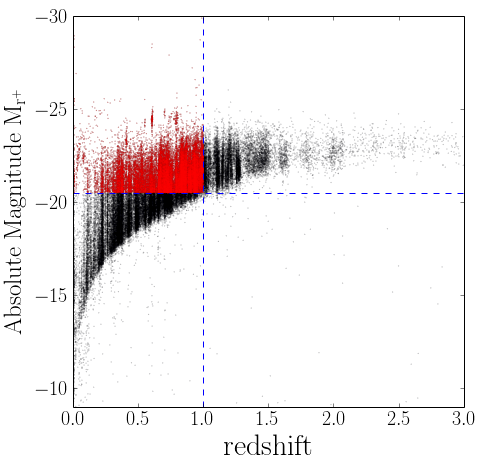

In [10]:
#3 Volume limit 
## - Justify r-band magnitude for limit? 
mag_cut = -20.5
mag_limit = (data['MR']<mag_cut)
f=plt.figure(figsize=(7,7))
plt.scatter(data['Z_BEST'],data['MR'],s=.01)
plt.scatter(data[mag_limit & z_limit]['Z_BEST'],data[mag_limit & z_limit]['MR'],s=.01,c='r',marker='o',edgecolor='r')
plt.xlim(0,3)
plt.ylim(-30,-9)
plt.gca().invert_yaxis()
plt.xlabel('$\mathrm{redshift}$',fontsize=30)
plt.ylabel('$\mathrm{Absolute~Magnitude~M_{r^+}}$',fontsize=25)

plt.axhline(y=mag_cut,ls='dashed')
plt.axvline(x=1,ls='dashed')
plt.savefig('../writeup/figures/mag_z_limit.pdf')

In [11]:
print 'Galaxies in mag+z limited sample: %s' %(len(data[z_limit & mag_limit]))

Galaxies in mag+z limited sample: 27584


## 4: GZH Morphologies: Select not-clumpy disks

Cuts will be set on $p_{features}$ and $p_{clumpy,no}$, *after* requiring $N_{edgeon}\ge10$


In [21]:
p_features = 't01_smooth_or_features_a02_features_or_disk_best_fraction'
p_clumpy_no = 't12_clumpy_a02_no_weighted_fraction'
p_edgeon_no = 't02_edgeon_a02_no_weighted_fraction'
N_edgeon = 't02_edgeon_total_weight'

p_features_cut = .23
p_clumpy_no_cut = .3
N_edgeon_cut = 10

featured = (data[p_features]>p_features_cut)
not_clumpy = (data[p_clumpy_no]>p_clumpy_no_cut)

disks = z_limit & mag_limit & featured & not_clumpy & (data[N_edgeon]>=10)

print 'Number of disks = %s'%len(data[disks])

Number of disks = 10423


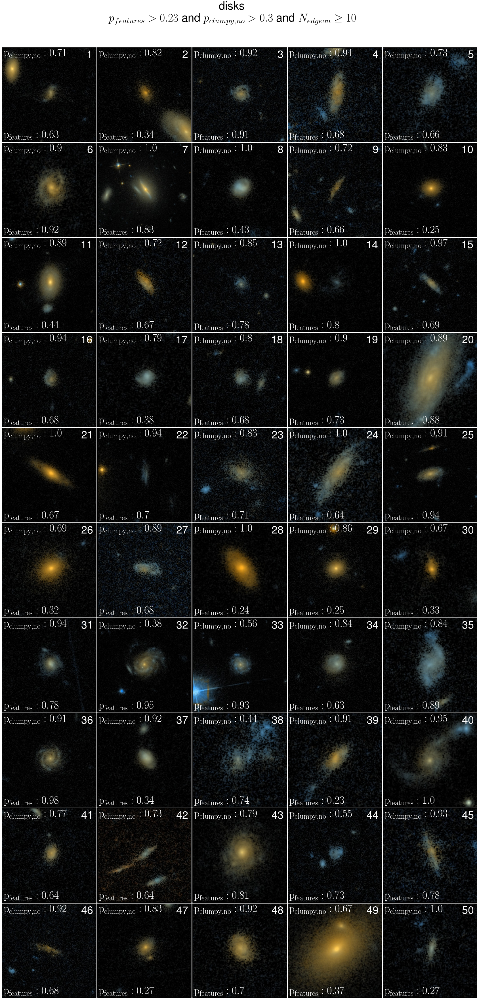

In [22]:
gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)
 
these_data=data[disks]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])
    
labels = np.linspace(1,50,50)

#now we have a random list of galaxies - sort them by p_features, column 119
#random_gal_list.sort(key=itemgetter(113))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{clumpy,no}: %s}$'%round(gal[p_clumpy_no],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')

        n+=1
        

f.text(.5,.92,'disks \n$p_{features} > %s$~and~$p_{clumpy,no}>%s$~and~$N_{edgeon} \ge 10$'%(p_features_cut,p_clumpy_no_cut), fontsize=40,ha='center')

# 5: Set cut on $p_{edgeon,no}$ to elminate highly inclined disks

As shown in a plot near the end of this notebook, the red sequence (as defined by a color-color plot) has an overabundance of highly inclined disks, suggesting their colors are more an indicator of dust-reddening than passivity. To ensure the measured colors are indicitave of actifity, highly inclined disks (which have low values of $p_{edgeon,no}$) will not be included in the sample. 

Small note: "face on" hereafter will mean 'not inclined to such a degree as to be impacted by dust-reddenning', and "edge on" will refer to the opposite. 

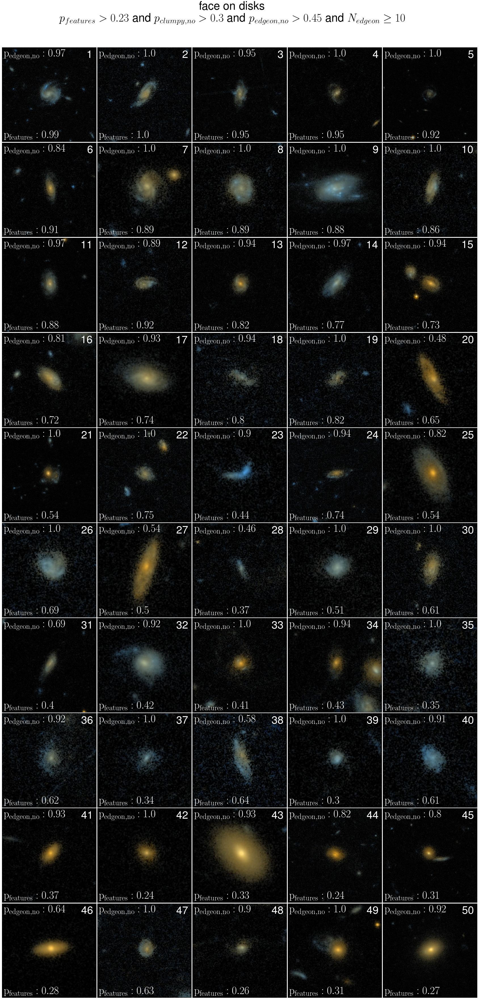

In [23]:
p_edgeon_no_cut = .45
gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

faceon = (data[p_edgeon_no]>p_edgeon_no_cut)
these_data=data[disks & faceon]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])
    
labels = np.linspace(1,50,50)

#now we have a random list of galaxies - sort them by p_edgeon_no, column 25
random_gal_list.sort(key=itemgetter(25))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{edgeon,no}: %s}$'%round(gal[p_edgeon_no],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')

        n+=1
        

f.text(.5,.92,'face on disks \n$p_{features} > %s$~and~$p_{clumpy,no}>%s$~and~$p_{edgeon,no}>%s$~and~$N_{edgeon} \ge 10$'%(p_features_cut,p_clumpy_no_cut,p_edgeon_no_cut), fontsize=40,ha='center')

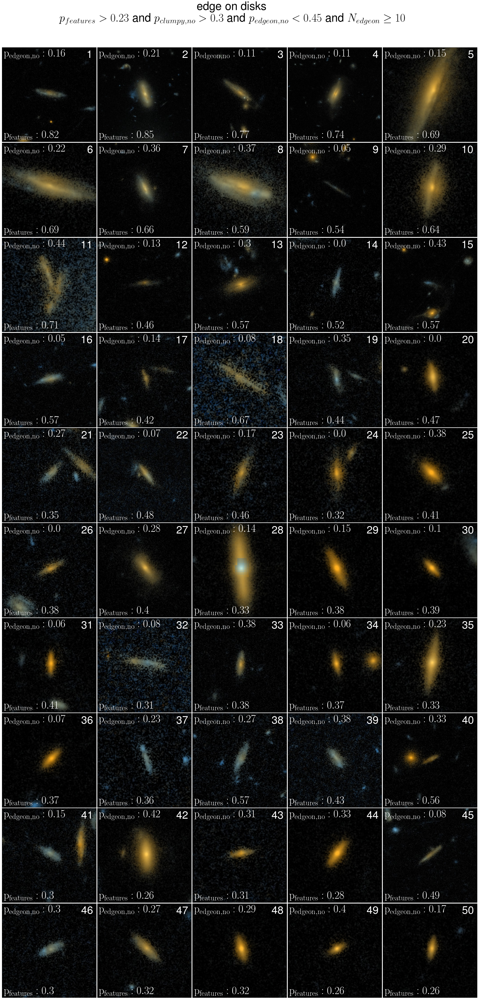

In [24]:
gs=gridspec.GridSpec(10,5)
gs.update(wspace=0.01)
gs.update(hspace=0.01)

edgeon = (data[p_edgeon_no]<p_edgeon_no_cut)
these_data=data[disks & edgeon]

if len(these_data) < 20:
    print 'try new values'

#shuffle which galaxies get displayed     
n_list=np.linspace(0,len(these_data)-1,len(these_data))
random.seed(3)
random.shuffle(n_list)

#how many galaxies to display?
n_gals = 50
random_n_list = n_list[0:n_gals]

random_gal_list = []
for n in random_n_list:
    random_gal_list.append(these_data[int(n)])
    
labels = np.linspace(1,50,50)

#now we have a random list of galaxies - sort them by p_edgeon_no, column 25
random_gal_list.sort(key=itemgetter(25))

f=plt.figure(figsize=(30,60))
n=0
for i in range (0,10):
    for j in range(0,5):
        ax=plt.subplot(gs[i,j])
        gal = random_gal_list[n] # random galaxy from big list 
        plt.imshow(get_image_from_url(gal['location']))
        plt.tick_params(labelbottom='off',labelleft='off')
        ax.annotate('$\mathrm{p_{edgeon,no}: %s}$'%round(gal[p_edgeon_no],2),fontsize=38,xy=(0.02,.97),
            xycoords='axes fraction',verticalalignment='top',color='white')

        ax.annotate('$\mathrm{p_{features}: %s}$'%round(gal[p_features],2),fontsize=38,xy=(0.02,.02),
            xycoords='axes fraction',color='white')
        ax.annotate('%s'%int(labels[n]),fontsize=38,xy=(0.97,0.97),
            xycoords='axes fraction',verticalalignment='top',horizontalalignment='right',color='white')

        n+=1
        

f.text(.5,.92,'edge on disks \n$p_{features} > %s$~and~$p_{clumpy,no}>%s$~and~$p_{edgeon,no}<%s$~and~$N_{edgeon} \ge 10$'%(p_features_cut,p_clumpy_no_cut,p_edgeon_no_cut), fontsize=40,ha='center')

# 6: Sort disks into red sequence and blue cloud. 

I use the classification system of the UltraVISTA catalog (Ilbert et al. 2013). They include a 'classification' label in their catalog; 0 indicates passive and 1 indicates star forming. The classifications were determined using a MNUV - MR vs MR - MJ diagram. The demarcation lines used to separate the populations are shown in the figure below. 

(-2, 8)

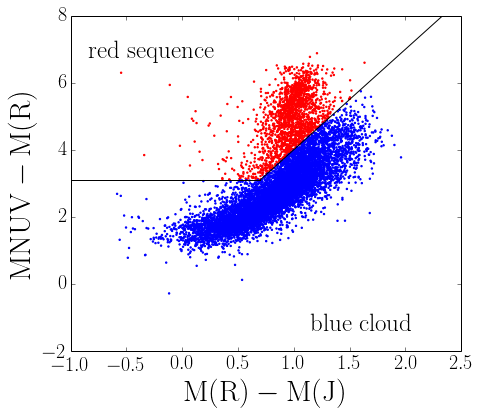

In [27]:
red_sequence = (data['classification']==0)
blue_cloud = (data['classification']==1)

f=plt.figure(figsize=(7,6))
plt.scatter(data[disks & red_sequence]['MR']-data[disks & red_sequence]['MJ'],data[disks & red_sequence]['MNUV']-data[disks & red_sequence]['MR'],s=2,edgecolor='r',c='r')
plt.scatter(data[disks & blue_cloud]['MR']-data[disks & blue_cloud]['MJ'],data[disks & blue_cloud]['MNUV']-data[disks & blue_cloud]['MR'],s=2,edgecolor='b',c='b')

x1=np.linspace(-5,.7,100)
x2=np.linspace(.7,5,100)
plt.plot(x1,3.1+0*x1,c='k')
plt.plot(x2,3*x2+1,c='k')
plt.ylabel('$\mathrm{MNUV-M(R)}$',fontsize=30)
plt.xlabel('$\mathrm{M(R)-M(J)}$',fontsize=30)
f.text(.16,.8,r'$\mathrm{red~sequence}$',fontsize=25)
f.text(.6,.17,r'$\mathrm{blue~cloud}$',fontsize=25)


plt.xlim(-1,2.5)
plt.ylim(-2,8)

# Justification of cutting highly inclined disks from sample

The plot below illustrates the necessity of an inclination cut. Inclination should not be a factor in the measured activity of a galaxy; yet the passive sample tends to be much more inclined than the active sample. As these are likely redder due to dust, and not a lack of activity, we exclude them from the sample. 

In [25]:
def Hist3D(xedges,yedges,the_data,colorhist):
    newmatrix = np.zeros(shape=(len(yedges)-1,len(xedges)-1))
    for i in range(0,len(yedges)-1):
        for j in range(0,len(xedges)-1):
            data_i_j = (the_data['MNUV']-the_data['MR']>=yedges[i]) & (the_data['MNUV']-the_data['MR'] < yedges[i+1]) & (the_data['MR']-the_data['MJ']>=xedges[j]) & (the_data['MR']-the_data['MJ']<xedges[j+1])
            newmatrix[i,j]=np.nanmean(the_data[data_i_j][p_edgeon_no])
    newmatrix=ma.masked_where(colorhist.T<10,newmatrix)
    return newmatrix

In [28]:
pec = faceon

#all disks
colorhist,xedge,yedge = np.histogram2d(data[disks]['MR']-data[disks]['MJ'],data[disks]['MNUV']-data[disks]['MR'],bins=(15,15))
extent=[xedge[0],xedge[-1],yedge[0],yedge[-1]]
this_hist=Hist3D(xedge,yedge,data[disks],colorhist)

colorhist_contour,xedge_contour,yedge_contour = np.histogram2d(data[disks]['MR']-data[disks]['MJ'],data[disks]['MNUV']-data[disks]['MR'],bins=(20,20))
extent_contour=[xedge_contour[0],xedge_contour[-1],yedge_contour[0],yedge_contour[-1]]


N_passive = len(data[disks & red_sequence])
N_SF = len(data[disks]) - N_passive

#face-on disks
colorhist_pec,xedge_pec,yedge_pec = np.histogram2d(data[disks & pec]['MR']-data[disks & pec]['MJ'],data[disks & pec]['MNUV']-data[disks & pec]['MR'],bins=(15,15))
extent_pec=[xedge_pec[0],xedge_pec[-1],yedge_pec[0],yedge_pec[-1]]
this_hist_pec=Hist3D(xedge_pec,yedge_pec,data[disks & pec],colorhist_pec)

colorhist_contour_pec,xedge_contour_pec,yedge_contour_pec = np.histogram2d(data[disks & pec]['MR']-data[disks & pec]['MJ'],data[disks & pec]['MNUV']-data[disks & pec]['MR'],bins=(20,20))
extent_contour_pec=[xedge_contour_pec[0],xedge_contour_pec[-1],yedge_contour_pec[0],yedge_contour_pec[-1]]

N_passive_pec = len(data[disks & red_sequence & pec])
N_SF_pec = len(data[disks & pec]) - N_passive_pec


mpl.rcParams['xtick.labelsize'] = 18
mpl.rcParams['ytick.labelsize'] = 18 

/usr/lib/pymodules/python2.7/matplotlib/collections.py:608: FutureWarning: elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison
  if self._edgecolors_original != 'face':


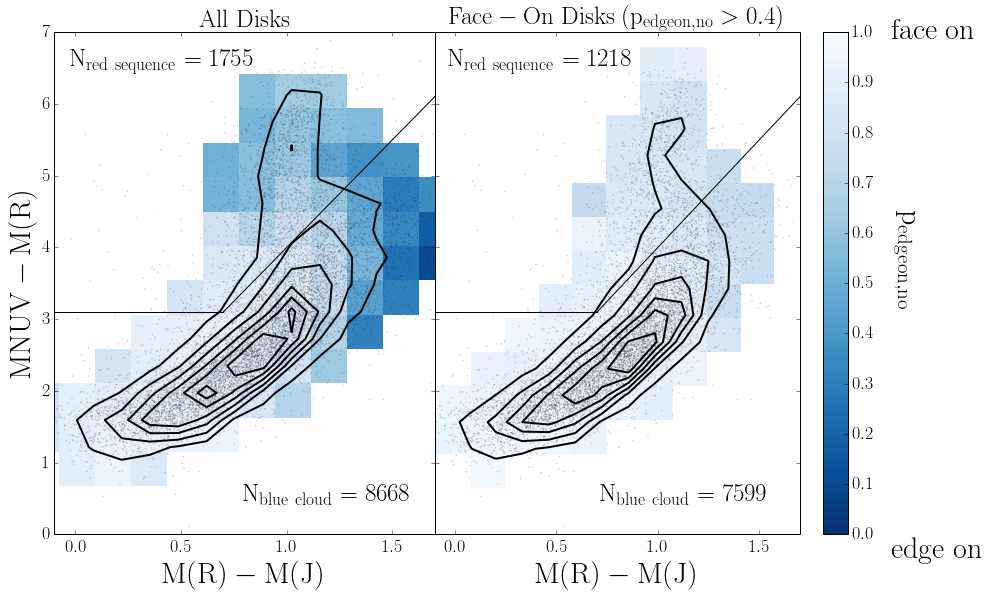

In [29]:
f=plt.figure(figsize=(15,9))
gs=gridspec.GridSpec(1,2,width_ratios=[1,1.2])
gs.update(wspace=0)

vmin = 0
vmax = 1
cmap=cm.Blues_r
alpha=.3

x1=np.linspace(-5,.7,100)
x2=np.linspace(.7,5,100)


ax=plt.subplot(gs[0,0])

plt.scatter(data[disks]['MR']-data[disks]['MJ'],data[disks]['MNUV']-data[disks]['MR'],s=.1,alpha=alpha)
plt.contour(colorhist_contour.T,extent=extent,colors='k',linewidths=2)
plt.imshow(this_hist,origin='lower',extent=extent_contour,interpolation='nearest',cmap=cmap,aspect='auto',vmin=vmin,vmax=vmax)
plt.ylim(0,7)
plt.xlim(-.1,1.7)
plt.ylabel('$\mathrm{MNUV-M(R)}$',fontsize=30)
plt.xlabel('$\mathrm{M(R)-M(J)}$',fontsize=30)
plt.plot(x1,3.1+0*x1,c='k')
plt.plot(x2,3*x2+1,c='k')
plt.title('$\mathrm{All~Disks}$',fontsize=25)

ax=plt.subplot(gs[0,1])

plt.scatter(data[disks & pec]['MR']-data[disks & pec]['MJ'],data[disks & pec]['MNUV']-data[disks & pec]['MR'],s=.1,alpha=alpha)
plt.contour(colorhist_contour_pec.T,extent=extent_pec,colors='k',linewidths=2)
plt.imshow(this_hist_pec,origin='lower',extent=extent_contour_pec,interpolation='nearest',cmap=cmap,aspect='auto',vmin=vmin,vmax=vmax)
plt.ylim(0,7)
plt.xlim(-.1,1.7)
plt.xlabel('$\mathrm{M(R)-M(J)}$',fontsize=30)
plt.tick_params(labelleft='off')
plt.plot(x1,3.1+0*x1,c='k')
plt.plot(x2,3*x2+1,c='k')
plt.title('$\mathrm{Face-On~Disks~(p_{edgeon,no}>%s)}$'%.4,fontsize=25)


plt.colorbar()
f.text(.9,.55,r'$\mathrm{p_{edgeon,no}}$',rotation=270,fontsize=30,va='center')
f.text(.9,.1,r'$\mathrm{edge~on}$',fontsize=30,va='center')
f.text(.9,.9,r'$\mathrm{face~on}$',fontsize=30,va='center')

#numbers
f.text(.14,.84,r'$\mathrm{N_{red~sequence}=%s}$'%N_passive,fontsize=25)
f.text(.3,.17,r'$\mathrm{N_{blue~cloud}=%s}$'%N_SF,fontsize=25)

f.text(.49,.84,r'$\mathrm{N_{red~sequence}=%s}$'%N_passive_pec,fontsize=25)
f.text(.63,.17,r'$\mathrm{N_{blue~cloud}=%s}$'%N_SF_pec,fontsize=25)

plt.savefig('../writeup/figures/edgeon_colorcolor.pdf')


In [32]:
# Write table of cuts in case of changes later
c1 = Column([p_features_cut], name='p_features_cut') 
c2 = Column([p_clumpy_no_cut], name='p_clumpy_no_cut')
c3 = Column([p_edgeon_no_cut], name='p_edgeon_no_cut')
c4 = Column([10.0],name='N_edgeon_cut')
c5 = Column([zl],name='z_lower')
c6 = Column([zh],name='z_upper')
c7 = Column([mag_cut],name='mag_cut')


cuts_table = Table()  
cuts_table.add_columns([c1,c2,c3,c4,c5,c6,c7])

fname = '../data/red_disk_cuts.fits'
if os.path.exists(fname):
    os.remove(fname)
cuts_table.write(fname,format='fits')

In [33]:
cuts_table

p_features_cut,p_clumpy_no_cut,p_edgeon_no_cut,N_edgeon_cut,z_lower,z_upper,mag_cut
float64,float64,float64,float64,int64,float64,float64
0.23,0.3,0.45,10.0,0,1.0,-20.5


In [35]:
len(data[disks & faceon])

8842